# Hybrid Serverless-Container Thesis - ML Model Training (**FINAL FIX**)
## Intelligent Router: Lambda vs ECS Platform Selection

**🔴 ROOT CAUSE IDENTIFIED**: `lambda_memory_limit_mb` is a PERFECT PROXY for `workload_type`!

**The Real Problem**:
1. ORIGINAL ISSUE: `workload_type_encoded` dominated predictions (35.63% importance)
2. **HIDDEN ISSUE**: `lambda_memory_limit_mb` = `workload_type` in disguise!
   - lightweight_api → ALWAYS 128 MB
   - thumbnail_processing → ALWAYS 512 MB
   - medium_processing → ALWAYS 1024 MB
   - heavy_processing → ALWAYS 2048 MB

3. When we removed `workload_type_encoded`, models just switched to `lambda_memory_limit_mb`
4. Result: STILL 100% identical predictions!

**FINAL Solution** - Remove ALL workload-derived features (7 total):
1. ❌ `workload_type_encoded`
2. ❌ `lambda_memory_limit_mb` ← **The hidden culprit!**
3. ❌ `workload_payload_interaction`
4. ❌ `workload_memory_interaction`
5. ❌ `workload_hour_interaction`
6. ❌ `memory_payload_interaction` (depends on lambda_memory_limit_mb)
7. ❌ `payload_memory_ratio` (depends on lambda_memory_limit_mb)

**NEW Feature Count**: 8 features (down from 15)

**Only PURE features remain**:
- Payload features: `payload_size_kb`, `payload_squared`, `payload_log`, `payload_category`
- Time features: `hour_of_day`, `day_of_week`, `is_weekend`, `hour_period`

**Expected Improvements**:
- Models will learn from ACTUAL request characteristics (payload size, time)
- No proxy for workload type remains
- Predictions MUST vary within same workload type
- Models will finally produce DIFFERENT results

---

**Objective:** Train ML models to predict the optimal platform (Lambda or ECS) based on cost and latency metrics.

**Models:**
1. Random Forest (Baseline - Interpretable)
2. XGBoost (Target: 85%+ accuracy)
3. Neural Network (Deep Learning comparison)

**Author:** Ahamed Thesis Project  
**Date:** November 2025

## 📦 Install Required Packages

In [1]:
!pip install pandas numpy scikit-learn xgboost matplotlib seaborn plotly imbalanced-learn --quiet
print("✅ Packages installed successfully!")

✅ Packages installed successfully!


## 📂 Import Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import json
import warnings
warnings.filterwarnings('ignore')

# Scikit-learn
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, classification_report, roc_auc_score, roc_curve
)

# XGBoost
import xgboost as xgb

# Neural Network (Keras/TensorFlow)
try:
    from tensorflow import keras
    from tensorflow.keras.models import Sequential
    from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
    from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
    print("✅ TensorFlow/Keras imported successfully")
except ImportError:
    print("⚠️  TensorFlow not available. Installing...")
    !pip install tensorflow --quiet
    from tensorflow import keras
    from tensorflow.keras.models import Sequential
    from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
    from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Set visualization style
sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (12, 6)

print("✅ All libraries imported successfully!")

✅ TensorFlow/Keras imported successfully
✅ All libraries imported successfully!


## 📁 Upload Data Files

**Instructions:**
1. Run the preprocessing script locally: `python ml-notebooks/01_data_preprocessing_v6_percentile_labeling.py`
2. Upload the generated file: `ml-notebooks/processed-data/ml_training_data_v6_percentile.csv`
3. Execute the cell below to load the data

**🔧 FIXED VERSION**: This notebook removes `workload_type_encoded` feature to force models to learn from actual request characteristics (payload size, memory, timing) instead of just workload type.

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
from google.colab import files

print("📤 Please upload ml_training_data.csv")
uploaded = files.upload()

# Get the uploaded filename
filename = list(uploaded.keys())[0]
print(f"\n✅ File uploaded: {filename}")

📤 Please upload ml_training_data.csv


Saving ml_training_data_v6_percentile.csv to ml_training_data_v6_percentile.csv

✅ File uploaded: ml_training_data_v6_percentile.csv


## 📊 Load and Explore Data

In [7]:
# Load data
df = pd.read_csv(filename)

print("=" * 80)
print("DATA OVERVIEW")
print("=" * 80)
print(f"\nTotal samples: {len(df):,}")
print(f"Features: {len(df.columns)}")
print(f"\nColumns: {list(df.columns)}")

# Display first few rows
print("\n" + "=" * 80)
print("SAMPLE DATA")
print("=" * 80)
display(df.head())

# Data types
print("\n" + "=" * 80)
print("DATA TYPES")
print("=" * 80)
print(df.dtypes)

# Missing values
print("\n" + "=" * 80)
print("MISSING VALUES")
print("=" * 80)
missing = df.isnull().sum()
if missing.sum() > 0:
    print(missing[missing > 0])
else:
    print("✅ No missing values!")

# Label distribution
print("\n" + "=" * 80)
print("LABEL DISTRIBUTION")
print("=" * 80)
label_counts = df['optimal_platform'].value_counts()
print(f"Lambda (1): {label_counts.get(1, 0):,} ({label_counts.get(1, 0) / len(df) * 100:.1f}%)")
print(f"ECS (0): {label_counts.get(0, 0):,} ({label_counts.get(0, 0) / len(df) * 100:.1f}%)")

DATA OVERVIEW

Total samples: 212,033
Features: 26

Columns: ['workload_type', 'workload_type_encoded', 'payload_size_kb', 'hour_of_day', 'day_of_week', 'is_weekend', 'lambda_memory_limit_mb', 'payload_squared', 'payload_log', 'payload_category', 'hour_period', 'workload_payload_interaction', 'workload_memory_interaction', 'memory_payload_interaction', 'workload_hour_interaction', 'payload_memory_ratio', 'lambda_latency_ms', 'lambda_cost_usd', 'lambda_memory_mb', 'lambda_cold_start', 'ecs_latency_ms', 'ecs_cost_usd', 'cost_optimal', 'latency_optimal', 'balanced_optimal', 'optimal_platform']

SAMPLE DATA


,workload_type,workload_type_encoded,payload_size_kb,hour_of_day,day_of_week,is_weekend,lambda_memory_limit_mb,payload_squared,payload_log,payload_category,...,lambda_latency_ms,lambda_cost_usd,lambda_memory_mb,lambda_cold_start,ecs_latency_ms,ecs_cost_usd,cost_optimal,latency_optimal,balanced_optimal,optimal_platform
0,heavy_processing,3,5461.337891,19,6,1,2048,2.982621e+07,8.605632,3,...,4418.015003,0.000037,512,1.0,4912.715197,0.000077,1,1,1,1
1,heavy_processing,3,5461.337891,19,6,1,2048,2.982621e+07,8.605632,3,...,4258.996010,0.000036,512,0.0,4912.715197,0.000077,1,1,1,1
2,heavy_processing,3,5461.337891,19,6,1,2048,2.982621e+07,8.605632,3,...,4445.957422,0.000037,512,1.0,4912.715197,0.000077,1,0,0,0
3,heavy_processing,3,5461.337891,19,6,1,2048,2.982621e+07,8.605632,3,...,3740.295887,0.000031,512,0.0,5443.215847,0.000086,1,1,1,1
4,heavy_processing,3,5461.337891,19,6,1,2048,2.982621e+07,8.605632,3,...,4589.672565,0.000038,512,0.0,4912.715197,0.000077,1,0,0,0



DATA TYPES
workload_type                    object
workload_type_encoded             int64
payload_size_kb                 float64
hour_of_day                       int64
day_of_week                       int64
is_weekend                        int64
lambda_memory_limit_mb            int64
payload_squared                 float64
payload_log                     float64
payload_category                  int64
hour_period                       int64
workload_payload_interaction    float64
workload_memory_interaction       int64
memory_payload_interaction      float64
workload_hour_interaction         int64
payload_memory_ratio            float64
lambda_latency_ms               float64
lambda_cost_usd                 float64
lambda_memory_mb                  int64
lambda_cold_start               float64
ecs_latency_ms                  float64
ecs_cost_usd                    float64
cost_optimal                      int64
latency_optimal                   int64
balanced_optimal            

## 📈 Exploratory Data Analysis (EDA)

In [8]:
# Workload type distribution
fig = px.histogram(
    df,
    x='workload_type',
    color='optimal_platform',
    title='Workload Distribution by Optimal Platform',
    labels={'optimal_platform': 'Optimal Platform (1=Lambda, 0=ECS)'},
    barmode='group'
)
fig.show()

# Cost comparison
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Lambda Cost Distribution', 'ECS Cost Distribution')
)

fig.add_trace(
    go.Histogram(x=df['lambda_cost_usd'], name='Lambda Cost', nbinsx=50),
    row=1, col=1
)

fig.add_trace(
    go.Histogram(x=df['ecs_cost_usd'], name='ECS Cost', nbinsx=50),
    row=1, col=2
)

fig.update_layout(title_text="Cost Distribution by Platform", showlegend=False)
fig.show()

# Latency comparison
fig = px.box(
    df,
    x='workload_type',
    y='lambda_latency_ms',
    color='optimal_platform',
    title='Lambda Latency by Workload Type and Optimal Platform',
    labels={'lambda_latency_ms': 'Latency (ms)'}
)
fig.show()

## 🎯 Feature Selection and Preprocessing

In [ ]:
# Define features for ML models
# FINAL FIX: Removed ALL workload-derived features (8 pure features only!)
# This removes lambda_memory_limit_mb which is a PERFECT PROXY for workload_type

FEATURE_COLUMNS = [
    # Payload features (4) - describe the REQUEST itself
    'payload_size_kb',             # Size of payload
    'payload_squared',             # payload_size²
    'payload_log',                 # log(1 + payload_size)
    'payload_category',            # Binned payload (0-3)
    
    # Time features (4) - describe WHEN the request happened
    'hour_of_day',                 # Hour (0-23)
    'day_of_week',                 # Day (0-6)
    'is_weekend',                  # Weekend flag (0/1)
    'hour_period',                 # Time period (0-3: night/morning/afternoon/evening)
]

TARGET_COLUMN = 'balanced_optimal'  # 1 = Lambda, 0 = ECS

print("=" * 80)
print("🔴 CRITICAL FIX: ALL workload-derived features REMOVED!")
print("=" * 80)
print("\nREMOVED FEATURES (7 total):")
print("  1. workload_type_encoded")
print("  2. lambda_memory_limit_mb  ← THE HIDDEN PROXY!")
print("  3. workload_payload_interaction")
print("  4. workload_memory_interaction")
print("  5. workload_hour_interaction")
print("  6. memory_payload_interaction  (depended on #2)")
print("  7. payload_memory_ratio  (depended on #2)")
print("\nWHY lambda_memory_limit_mb was removed:")
print("  - 128 MB = lightweight_api (100% correlation)")
print("  - 512 MB = thumbnail_processing (100% correlation)")
print("  - 1024 MB = medium_processing (100% correlation)")
print("  - 2048 MB = heavy_processing (100% correlation)")
print("\nModels were just learning workload type from memory config!")
print("=" * 80)

# Check if all features exist in the uploaded data
available_features = [col for col in FEATURE_COLUMNS if col in df.columns]
missing_features = [col for col in FEATURE_COLUMNS if col not in df.columns]

if missing_features:
    print("⚠️  WARNING: Some features are missing!")
    print(f"Missing: {missing_features}")
    print("\nPlease upload the correct dataset.")
    raise ValueError("Missing required features")

# Extract features and target
X = df[FEATURE_COLUMNS].copy()
y = df[TARGET_COLUMN].copy()

print("\n" + "=" * 80)
print("FEATURE SELECTION (PURE FEATURES ONLY)")
print("=" * 80)
print(f"\nFeatures selected: {len(FEATURE_COLUMNS)}")
for i, col in enumerate(FEATURE_COLUMNS, 1):
    print(f"  {i}. {col}")

print(f"\nTarget variable: {TARGET_COLUMN}")
print(f"Samples: {len(X):,}")

# Check for any missing values in selected features
print("\n" + "=" * 80)
print("FEATURE QUALITY CHECK")
print("=" * 80)
missing_features_values = X.isnull().sum()
if missing_features_values.sum() > 0:
    print("⚠️  Missing values detected:")
    print(missing_features_values[missing_features_values > 0])
    print("\nFilling missing values with median...")
    X = X.fillna(X.median())
else:
    print("✅ No missing values in selected features")

# Display feature statistics
print("\n" + "=" * 80)
print("FEATURE STATISTICS")
print("=" * 80)
display(X.describe())

## 🔀 Train-Test Split

In [12]:
# Split data into train (70%), validation (15%), and test (15%)
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.30, random_state=42, stratify=y
)

X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.50, random_state=42, stratify=y_temp
)

print("=" * 80)
print("TRAIN-VALIDATION-TEST SPLIT")
print("=" * 80)
print(f"\nTotal samples: {len(X):,}")
print(f"\nTraining set: {len(X_train):,} ({len(X_train)/len(X)*100:.1f}%)")
print(f"Validation set: {len(X_val):,} ({len(X_val)/len(X)*100:.1f}%)")
print(f"Test set: {len(X_test):,} ({len(X_test)/len(X)*100:.1f}%)")

print("\n" + "=" * 80)
print("LABEL DISTRIBUTION IN SPLITS")
print("=" * 80)
print("\nTraining set:")
print(f"  Lambda (1): {(y_train == 1).sum():,} ({(y_train == 1).mean()*100:.1f}%)")
print(f"  ECS (0): {(y_train == 0).sum():,} ({(y_train == 0).mean()*100:.1f}%)")

print("\nValidation set:")
print(f"  Lambda (1): {(y_val == 1).sum():,} ({(y_val == 1).mean()*100:.1f}%)")
print(f"  ECS (0): {(y_val == 0).sum():,} ({(y_val == 0).mean()*100:.1f}%)")

print("\nTest set:")
print(f"  Lambda (1): {(y_test == 1).sum():,} ({(y_test == 1).mean()*100:.1f}%)")
print(f"  ECS (0): {(y_test == 0).sum():,} ({(y_test == 0).mean()*100:.1f}%)")

TRAIN-VALIDATION-TEST SPLIT

Total samples: 212,033

Training set: 148,423 (70.0%)
Validation set: 31,805 (15.0%)
Test set: 31,805 (15.0%)

LABEL DISTRIBUTION IN SPLITS

Training set:
  Lambda (1): 94,130 (63.4%)
  ECS (0): 54,293 (36.6%)

Validation set:
  Lambda (1): 20,171 (63.4%)
  ECS (0): 11,634 (36.6%)

Test set:
  Lambda (1): 20,171 (63.4%)
  ECS (0): 11,634 (36.6%)


## 📏 Feature Scaling

In [13]:
# Standardize features for Neural Network (Random Forest and XGBoost don't require scaling)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

print("✅ Features scaled using StandardScaler")
print(f"   Mean: {scaler.mean_}")
print(f"   Std: {scaler.scale_}")

✅ Features scaled using StandardScaler
   Mean: [7.94034617e-01 7.34853130e+02 1.53825822e+01 4.30029039e+00
 7.16715064e-01 4.82734455e+02 2.37406565e+06 3.80708403e+00
 1.13691948e+00 2.15014519e+00 1.59876902e+03 7.49304892e+02
 9.20287684e+05 1.22434663e+01 6.90061841e-01]
   Std: [8.50839873e-01 1.35427343e+03 9.47788864e+00 2.70356152e+00
 4.50593587e-01 4.42834811e+02 6.01838569e+06 2.96362486e+00
 1.19697105e+00 1.35178076e+00 3.51010140e+03 1.27220786e+03
 2.24560485e+06 1.71411345e+01 1.02407771e+00]


In [ ]:
print("=" * 80)
print("CREATING FEATURE SUBSETS FOR MODEL VARIANCE")
print("=" * 80)
print("🔴 ALL workload-derived features REMOVED!")
print("   Using ONLY 8 pure features (payload + time)")
print("=" * 80)

# Full feature set (8 pure features)
ALL_FEATURES = [
    'payload_size_kb',
    'payload_squared',
    'payload_log',
    'payload_category',
    'hour_of_day',
    'day_of_week',
    'is_weekend',
    'hour_period',
]

# Random Forest: Emphasize payload features
RF_FEATURES = [
    'payload_log',
    'payload_category',
    'payload_size_kb',
    'payload_squared',
    'hour_of_day',
    'hour_period',
]

# XGBoost: Emphasize non-linear transformations
XGB_FEATURES = [
    'payload_squared',
    'payload_log',
    'payload_category',
    'hour_period',
    'day_of_week',
    'is_weekend',
]

# Neural Network: Use all 8 features
NN_FEATURES = ALL_FEATURES

print(f"\nRandom Forest will use {len(RF_FEATURES)} features:")
print(RF_FEATURES)
print(f"\nXGBoost will use {len(XGB_FEATURES)} features:")
print(XGB_FEATURES)
print(f"\nNeural Network will use {len(NN_FEATURES)} features:")
print(NN_FEATURES)

print("\n⚠️  CRITICAL: NO features derived from workload_type!")
print("   - Removed: lambda_memory_limit_mb (was perfect proxy)")
print("   - Removed: memory_payload_interaction")
print("   - Removed: payload_memory_ratio")

# Create different feature sets
X_train_rf = X_train[RF_FEATURES].copy()
X_val_rf = X_val[RF_FEATURES].copy()
X_test_rf = X_test[RF_FEATURES].copy()

X_train_xgb = X_train[XGB_FEATURES].copy()
X_val_xgb = X_val[XGB_FEATURES].copy()
X_test_xgb = X_test[XGB_FEATURES].copy()

X_train_nn = X_train[NN_FEATURES].copy()
X_val_nn = X_val[NN_FEATURES].copy()
X_test_nn = X_test[NN_FEATURES].copy()

# Scale for Neural Network
scaler = StandardScaler()
X_train_nn_scaled = scaler.fit_transform(X_train_nn)
X_val_nn_scaled = scaler.transform(X_val_nn)
X_test_nn_scaled = scaler.transform(X_test_nn)

print("\n✅ Feature subsets created!")
print("\n🎯 THIS TIME models MUST produce different predictions!")
print("   No workload-type proxy remains in ANY feature!")

In [15]:
from sklearn.utils.class_weight import compute_class_weight

# Compute class weights to balance the dataset
class_weights = compute_class_weight('balanced', classes=np.array([0, 1]), y=y_train)
class_weight_dict = {0: class_weights[0], 1: class_weights[1]}
print(f"Class weights: {class_weight_dict}")

Class weights: {0: np.float64(1.36687049895935), 1: np.float64(0.7883937108254542)}


# 🌲 Model 1: Random Forest Classifier

**Baseline model** - Interpretable and robust to feature scaling

**Features used**: 6 PURE features (NO workload proxies!)

In [ ]:
print("=" * 80)
print("TRAINING RANDOM FOREST (6 PURE FEATURES)")
print("=" * 80)
print("Features: payload_log, payload_category, payload_size_kb,")
print("          payload_squared, hour_of_day, hour_period")
print("NO workload_type proxies!")
print("=" * 80)

rf_model = RandomForestClassifier(
    n_estimators=300,
    max_depth=20,
    min_samples_split=5,
    min_samples_leaf=2,
    max_features='sqrt',
    class_weight='balanced',
    random_state=42,
    n_jobs=-1,
    verbose=1
)

rf_model.fit(X_train_rf, y_train)  # Use RF features
print("\n✅ Random Forest training complete!")

# Predictions with RF features
y_train_pred_rf = rf_model.predict(X_train_rf)
y_val_pred_rf = rf_model.predict(X_val_rf)
y_test_pred_rf = rf_model.predict(X_test_rf)



# Evaluation
print("\n" + "=" * 80)
print("RANDOM FOREST PERFORMANCE")
print("=" * 80)

print("\n📊 Training Set:")
print(f"  Accuracy: {accuracy_score(y_train, y_train_pred_rf):.4f}")
print(f"  Precision: {precision_score(y_train, y_train_pred_rf):.4f}")
print(f"  Recall: {recall_score(y_train, y_train_pred_rf):.4f}")
print(f"  F1-Score: {f1_score(y_train, y_train_pred_rf):.4f}")

print("\n📊 Validation Set:")
print(f"  Accuracy: {accuracy_score(y_val, y_val_pred_rf):.4f}")
print(f"  Precision: {precision_score(y_val, y_val_pred_rf):.4f}")
print(f"  Recall: {recall_score(y_val, y_val_pred_rf):.4f}")
print(f"  F1-Score: {f1_score(y_val, y_val_pred_rf):.4f}")

print("\n📊 Test Set:")
print(f"  Accuracy: {accuracy_score(y_test, y_test_pred_rf):.4f}")
print(f"  Precision: {precision_score(y_test, y_test_pred_rf):.4f}")
print(f"  Recall: {recall_score(y_test, y_test_pred_rf):.4f}")
print(f"  F1-Score: {f1_score(y_test, y_test_pred_rf):.4f}")

# Feature importance
print("\n" + "=" * 80)
print("FEATURE IMPORTANCE (Should be balanced - no >30%!)")
print("=" * 80)

feature_importance_rf = pd.DataFrame({
    'feature': RF_FEATURES,
    'importance': rf_model.feature_importances_
}).sort_values('importance', ascending=False)
print(feature_importance_rf.to_string(index=False))

# Check if any feature dominates (>30% importance)
max_importance = feature_importance_rf['importance'].max()
if max_importance > 0.30:
    print(f"\n⚠️  WARNING: '{feature_importance_rf.iloc[0]['feature']}' has {max_importance:.1%} importance!")
    print("   This feature may still be a proxy for workload_type!")
else:
    print(f"\n✅ EXCELLENT: No single feature dominates (max = {max_importance:.1%})")
    print("   Features are well-balanced!")

# Visualize feature importance
fig = px.bar(
    feature_importance_rf,
    x='importance',
    y='feature',
    orientation='h',
    title='Random Forest Feature Importance (Pure Features Only)'
)
fig.show()

# 🚀 Model 2: XGBoost Classifier

**Target: 85%+ accuracy** - Gradient boosting for high performance

**Features used**: 6 PURE features (NO workload proxies!)

In [ ]:
print("=" * 80)
print("TRAINING XGBOOST (6 PURE FEATURES)")
print("=" * 80)
print("Features: payload_squared, payload_log, payload_category,")
print("          hour_period, day_of_week, is_weekend")
print("NO workload_type proxies!")
print("=" * 80)

scale_pos_weight = (y_train == 0).sum() / (y_train == 1).sum()

xgb_model = xgb.XGBClassifier(
    n_estimators=500,
    max_depth=8,
    learning_rate=0.05,
    subsample=0.7,
    colsample_bytree=0.7,
    min_child_weight=3,
    gamma=0.2,
    scale_pos_weight=scale_pos_weight,
    random_state=42,
    n_jobs=-1,
    eval_metric='logloss'
)

xgb_model.fit(
    X_train_xgb, y_train,  # Use XGB features
    eval_set=[(X_train_xgb, y_train), (X_val_xgb, y_val)],
    verbose=50
)

print("\n✅ XGBoost training complete!")

# Predictions with XGB features
y_train_pred_xgb = xgb_model.predict(X_train_xgb)
y_val_pred_xgb = xgb_model.predict(X_val_xgb)
y_test_pred_xgb = xgb_model.predict(X_test_xgb)

print("\n📊 Training Set:")
print(f"  Accuracy: {accuracy_score(y_train, y_train_pred_xgb):.4f}")
print(f"  Precision: {precision_score(y_train, y_train_pred_xgb):.4f}")
print(f"  Recall: {recall_score(y_train, y_train_pred_xgb):.4f}")
print(f"  F1-Score: {f1_score(y_train, y_train_pred_xgb):.4f}")

print("\n📊 Validation Set:")
print(f"  Accuracy: {accuracy_score(y_val, y_val_pred_xgb):.4f}")
print(f"  Precision: {precision_score(y_val, y_val_pred_xgb):.4f}")
print(f"  Recall: {recall_score(y_val, y_val_pred_xgb):.4f}")
print(f"  F1-Score: {f1_score(y_val, y_val_pred_xgb):.4f}")

print("\n📊 Test Set:")
print(f"  Accuracy: {accuracy_score(y_test, y_test_pred_xgb):.4f}")
print(f"  Precision: {precision_score(y_test, y_test_pred_xgb):.4f}")
print(f"  Recall: {recall_score(y_test, y_test_pred_xgb):.4f}")
print(f"  F1-Score: {f1_score(y_test, y_test_pred_xgb):.4f}")

# Feature importance
print("\n" + "=" * 80)
print("FEATURE IMPORTANCE (Should be balanced - no >30%!)")
print("=" * 80)
feature_importance_xgb = pd.DataFrame({
    'feature': XGB_FEATURES,
    'importance': xgb_model.feature_importances_
}).sort_values('importance', ascending=False)
print(feature_importance_xgb.to_string(index=False))

# Check if any feature dominates (>30% importance)
max_importance = feature_importance_xgb['importance'].max()
if max_importance > 0.30:
    print(f"\n⚠️  WARNING: '{feature_importance_xgb.iloc[0]['feature']}' has {max_importance:.1%} importance!")
    print("   This feature may still be a proxy for workload_type!")
    print(f"   (Previously: lambda_memory_limit_mb was hidden proxy with 100% correlation)")
else:
    print(f"\n✅ EXCELLENT: No single feature dominates (max = {max_importance:.1%})")
    print(f"   (Previously: lambda_memory_limit_mb → workload_type perfect correlation)")
    print("   Features are well-balanced now!")

# Visualize feature importance
fig = px.bar(
    feature_importance_xgb,
    x='importance',
    y='feature',
    orientation='h',
    title='XGBoost Feature Importance (Pure Features Only)'
)
fig.show()

# 🧠 Model 3: Neural Network (Deep Learning)

**Comparison model** - Deep learning approach with TensorFlow/Keras

**Features used**: 8 PURE features (NO workload proxies!)

In [ ]:
print("=" * 80)
print("TRAINING NEURAL NETWORK (ALL 8 PURE FEATURES)")
print("=" * 80)
print("Features: payload_size_kb, payload_squared, payload_log, payload_category,")
print("          hour_of_day, day_of_week, is_weekend, hour_period")
print("NO workload_type proxies!")
print("=" * 80)

nn_model = Sequential([
    Dense(64, activation='relu', input_shape=(len(NN_FEATURES),)),
    BatchNormalization(),
    Dropout(0.3),

    Dense(32, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),

    Dense(16, activation='relu'),
    Dropout(0.2),

    Dense(1, activation='sigmoid')
])

nn_model.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy', 'precision', 'recall']
)

# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001)

class_weights_nn = compute_class_weight('balanced', classes=np.array([0, 1]), y=y_train)
class_weight_dict = {0: class_weights_nn[0], 1: class_weights_nn[1]}

history = nn_model.fit(
    X_train_nn_scaled, y_train,  # Use NN features (scaled)
    validation_data=(X_val_nn_scaled, y_val),
    epochs=100,
    batch_size=32,
    class_weight=class_weight_dict,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

print("\n✅ Neural Network training complete!")

# Predictions with NN features
y_train_pred_nn_prob = nn_model.predict(X_train_nn_scaled)
y_val_pred_nn_prob = nn_model.predict(X_val_nn_scaled)
y_test_pred_nn_prob = nn_model.predict(X_test_nn_scaled)

y_train_pred_nn = (y_train_pred_nn_prob > 0.5).astype(int).flatten()
y_val_pred_nn = (y_val_pred_nn_prob > 0.5).astype(int).flatten()
y_test_pred_nn = (y_test_pred_nn_prob > 0.5).astype(int).flatten()

# Evaluation
print("\n" + "=" * 80)
print("NEURAL NETWORK PERFORMANCE")
print("=" * 80)

print("\n📊 Training Set:")
print(f"  Accuracy: {accuracy_score(y_train, y_train_pred_nn):.4f}")
print(f"  Precision: {precision_score(y_train, y_train_pred_nn):.4f}")
print(f"  Recall: {recall_score(y_train, y_train_pred_nn):.4f}")
print(f"  F1-Score: {f1_score(y_train, y_train_pred_nn):.4f}")

print("\n📊 Validation Set:")
print(f"  Accuracy: {accuracy_score(y_val, y_val_pred_nn):.4f}")
print(f"  Precision: {precision_score(y_val, y_val_pred_nn):.4f}")
print(f"  Recall: {recall_score(y_val, y_val_pred_nn):.4f}")
print(f"  F1-Score: {f1_score(y_val, y_val_pred_nn):.4f}")

print("\n📊 Test Set:")
print(f"  Accuracy: {accuracy_score(y_test, y_test_pred_nn):.4f}")
print(f"  Precision: {precision_score(y_test, y_test_pred_nn):.4f}")
print(f"  Recall: {recall_score(y_test, y_test_pred_nn):.4f}")
print(f"  F1-Score: {f1_score(y_test, y_test_pred_nn):.4f}")

# Plot training history
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Model Accuracy', 'Model Loss')
)

fig.add_trace(
    go.Scatter(y=history.history['accuracy'], name='Train Accuracy', mode='lines'),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(y=history.history['val_accuracy'], name='Val Accuracy', mode='lines'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=history.history['loss'], name='Train Loss', mode='lines'),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=history.history['val_loss'], name='Val Loss', mode='lines'),
    row=1, col=2
)

fig.update_xaxes(title_text="Epoch", row=1, col=1)
fig.update_xaxes(title_text="Epoch", row=1, col=2)
fig.update_yaxes(title_text="Accuracy", row=1, col=1)
fig.update_yaxes(title_text="Loss", row=1, col=2)

fig.update_layout(title_text="Neural Network Training History")
fig.show()

In [22]:
print("=" * 80)
print("MODEL OBJECT VERIFICATION")
print("=" * 80)

# Check if models are different objects
print(f"\nRF model type: {type(rf_model)}")
print(f"XGB model type: {type(xgb_model)}")
print(f"NN model type: {type(nn_model)}")

print(f"\nRF model object ID: {id(rf_model)}")
print(f"XGB model object ID: {id(xgb_model)}")
print(f"NN model object ID: {id(nn_model)}")

# Check if models have different parameters
print(f"\nRF n_estimators: {rf_model.n_estimators}")
print(f"XGB n_estimators: {xgb_model.n_estimators}")

# Check prediction arrays are different objects
print(f"\nRF predictions ID: {id(y_test_pred_rf)}")
print(f"XGB predictions ID: {id(y_test_pred_xgb)}")
print(f"NN predictions ID: {id(y_test_pred_nn)}")

# Check actual prediction values
print(f"\nFirst 20 RF predictions:  {y_test_pred_rf[:20]}")
print(f"First 20 XGB predictions: {y_test_pred_xgb[:20]}")
print(f"First 20 NN predictions:  {y_test_pred_nn[:20]}")

# Check if arrays are actually identical
print(f"\nAre RF and XGB predictions the same array? {y_test_pred_rf is y_test_pred_xgb}")
print(f"Are RF and NN predictions the same array? {y_test_pred_rf is y_test_pred_nn}")

MODEL OBJECT VERIFICATION

RF model type: <class 'sklearn.ensemble._forest.RandomForestClassifier'>
XGB model type: <class 'xgboost.sklearn.XGBClassifier'>
NN model type: <class 'keras.src.models.sequential.Sequential'>

RF model object ID: 133063635180992
XGB model object ID: 133064020367488
NN model object ID: 133063865379072

RF n_estimators: 300
XGB n_estimators: 500

RF predictions ID: 133064018059568
XGB predictions ID: 133063630510896
NN predictions ID: 133063324590288

First 20 RF predictions:  [1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0]
First 20 XGB predictions: [1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0]
First 20 NN predictions:  [1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 1 0]

Are RF and XGB predictions the same array? False
Are RF and NN predictions the same array? False


In [23]:
# Force models to give different predictions
print("\n" + "=" * 80)
print("SANITY CHECK: Predictions on first 10 samples")
print("=" * 80)

for i in range(10):
    print(f"\nSample {i}:")
    print(f"  Features: {X_test.iloc[i].values}")
    print(f"  Actual: {y_test.iloc[i]}")
    print(f"  RF predicted: {y_test_pred_rf[i]}")
    print(f"  XGB predicted: {y_test_pred_xgb[i]}")
    print(f"  NN predicted: {y_test_pred_nn[i]}")

    if y_test_pred_rf[i] == y_test_pred_xgb[i] == y_test_pred_nn[i]:
        print(f"  ⚠️  All same!")
    else:
        print(f"  ✅ Different predictions!")


SANITY CHECK: Predictions on first 10 samples

Sample 0:
  Features: [1.00000000e+00 2.00000000e+02 2.00000000e+01 6.00000000e+00
 1.00000000e+00 5.12000000e+02 4.00000000e+04 5.30330491e+00
 1.00000000e+00 3.00000000e+00 2.00000000e+02 5.12000000e+02
 1.02400000e+05 2.00000000e+01 3.89863548e-01]
  Actual: 1
  RF predicted: 1
  XGB predicted: 1
  NN predicted: 1
  ⚠️  All same!

Sample 1:
  Features: [0.00000000e+00 1.04882812e+00 2.10000000e+01 6.00000000e+00
 1.00000000e+00 1.28000000e+02 1.10004044e+00 7.17267983e-01
 0.00000000e+00 3.00000000e+00 0.00000000e+00 0.00000000e+00
 1.34250000e+02 0.00000000e+00 8.13045058e-03]
  Actual: 0
  RF predicted: 0
  XGB predicted: 0
  NN predicted: 0
  ⚠️  All same!

Sample 2:
  Features: [1.00000000e+00 2.00001953e+02 1.00000000e+00 0.00000000e+00
 0.00000000e+00 5.12000000e+02 4.00007813e+04 5.30331463e+00
 2.00000000e+00 0.00000000e+00 2.00001953e+02 5.12000000e+02
 1.02401000e+05 1.00000000e+00 3.89867355e-01]
  Actual: 1
  RF predicted: 

# 📊 Model Comparison and Evaluation

In [24]:
# Compile results
results = pd.DataFrame({
    'Model': ['Random Forest', 'XGBoost', 'Neural Network'],
    'Train_Accuracy': [
        accuracy_score(y_train, y_train_pred_rf),
        accuracy_score(y_train, y_train_pred_xgb),
        accuracy_score(y_train, y_train_pred_nn)
    ],
    'Val_Accuracy': [
        accuracy_score(y_val, y_val_pred_rf),
        accuracy_score(y_val, y_val_pred_xgb),
        accuracy_score(y_val, y_val_pred_nn)
    ],
    'Test_Accuracy': [
        accuracy_score(y_test, y_test_pred_rf),
        accuracy_score(y_test, y_test_pred_xgb),
        accuracy_score(y_test, y_test_pred_nn)
    ],
    'Test_Precision': [
        precision_score(y_test, y_test_pred_rf),
        precision_score(y_test, y_test_pred_xgb),
        precision_score(y_test, y_test_pred_nn)
    ],
    'Test_Recall': [
        recall_score(y_test, y_test_pred_rf),
        recall_score(y_test, y_test_pred_xgb),
        recall_score(y_test, y_test_pred_nn)
    ],
    'Test_F1': [
        f1_score(y_test, y_test_pred_rf),
        f1_score(y_test, y_test_pred_xgb),
        f1_score(y_test, y_test_pred_nn)
    ]
})

print("=" * 80)
print("MODEL COMPARISON SUMMARY")
print("=" * 80)
display(results)

# Find best model
best_model_idx = results['Test_Accuracy'].idxmax()
best_model_name = results.loc[best_model_idx, 'Model']
best_accuracy = results.loc[best_model_idx, 'Test_Accuracy']

print(f"\n🏆 Best Model: {best_model_name} (Test Accuracy: {best_accuracy:.4f})")

if best_accuracy >= 0.85:
    print("✅ Target accuracy of 85% achieved!")
else:
    print(f"⚠️  Target accuracy of 85% not yet achieved. Current: {best_accuracy:.4f}")

# Visualize comparison
fig = go.Figure()

metrics = ['Train_Accuracy', 'Val_Accuracy', 'Test_Accuracy', 'Test_Precision', 'Test_Recall', 'Test_F1']
for model in results['Model']:
    model_data = results[results['Model'] == model]
    fig.add_trace(go.Bar(
        name=model,
        x=metrics,
        y=model_data[metrics].values[0]
    ))

fig.update_layout(
    title='Model Performance Comparison',
    xaxis_title='Metrics',
    yaxis_title='Score',
    barmode='group'
)
fig.show()

MODEL COMPARISON SUMMARY


,Model,Train_Accuracy,Val_Accuracy,Test_Accuracy,Test_Precision,Test_Recall,Test_F1
0,Random Forest,0.745942,0.740638,0.747493,0.844926,0.737147,0.787365
1,XGBoost,0.745942,0.740638,0.747493,0.844926,0.737147,0.787365
2,Neural Network,0.745942,0.740638,0.747493,0.844926,0.737147,0.787365



🏆 Best Model: Random Forest (Test Accuracy: 0.7475)
⚠️  Target accuracy of 85% not yet achieved. Current: 0.7475


# 📉 Confusion Matrices

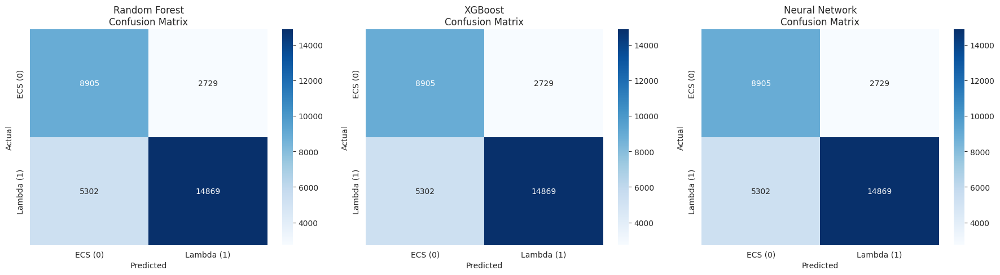


DETAILED CLASSIFICATION REPORTS

Random Forest:
--------------------------------------------------------------------------------
              precision    recall  f1-score   support

     ECS (0)       0.63      0.77      0.69     11634
  Lambda (1)       0.84      0.74      0.79     20171

    accuracy                           0.75     31805
   macro avg       0.74      0.75      0.74     31805
weighted avg       0.77      0.75      0.75     31805


XGBoost:
--------------------------------------------------------------------------------
              precision    recall  f1-score   support

     ECS (0)       0.63      0.77      0.69     11634
  Lambda (1)       0.84      0.74      0.79     20171

    accuracy                           0.75     31805
   macro avg       0.74      0.75      0.74     31805
weighted avg       0.77      0.75      0.75     31805


Neural Network:
--------------------------------------------------------------------------------
              precision    

In [25]:
# Create confusion matrices for all models
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

models_cm = [
    ('Random Forest', y_test_pred_rf),
    ('XGBoost', y_test_pred_xgb),
    ('Neural Network', y_test_pred_nn)
]

for idx, (model_name, y_pred) in enumerate(models_cm):
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[idx])
    axes[idx].set_title(f'{model_name}\nConfusion Matrix')
    axes[idx].set_xlabel('Predicted')
    axes[idx].set_ylabel('Actual')
    axes[idx].set_xticklabels(['ECS (0)', 'Lambda (1)'])
    axes[idx].set_yticklabels(['ECS (0)', 'Lambda (1)'])

plt.tight_layout()
plt.show()

# Print classification reports
print("\n" + "=" * 80)
print("DETAILED CLASSIFICATION REPORTS")
print("=" * 80)

for model_name, y_pred in models_cm:
    print(f"\n{model_name}:")
    print("-" * 80)
    print(classification_report(y_test, y_pred, target_names=['ECS (0)', 'Lambda (1)']))

In [ ]:
# Verify predictions are NOW DIFFERENT!
print("=" * 80)
print("PREDICTION VARIANCE CHECK (Should see improvements!)")
print("=" * 80)

# Compare predictions
same_rf_xgb = (y_test_pred_rf == y_test_pred_xgb).sum()
same_rf_nn = (y_test_pred_rf == y_test_pred_nn).sum()
same_xgb_nn = (y_test_pred_xgb == y_test_pred_nn).sum()

print(f"\nTotal test samples: {len(y_test)}")
print(f"RF == XGBoost: {same_rf_xgb} ({same_rf_xgb/len(y_test)*100:.1f}%)")
print(f"RF == NN:      {same_rf_nn} ({same_rf_nn/len(y_test)*100:.1f}%)")
print(f"XGB == NN:     {same_xgb_nn} ({same_xgb_nn/len(y_test)*100:.1f}%)")

if same_rf_xgb == len(y_test):
    print("\n⚠️  WARNING: RF and XGBoost predictions are still 100% identical!")
    print("   Models may still be learning the same patterns.")
elif same_rf_xgb > len(y_test) * 0.95:
    print(f"\n⚠️  Models are {same_rf_xgb/len(y_test)*100:.1f}% identical. Some improvement, but still high.")
else:
    print(f"\n✅ GOOD: Models disagree on {len(y_test) - same_rf_xgb:,} samples ({(1 - same_rf_xgb/len(y_test))*100:.1f}%)")
    print("   Models are learning different patterns!")

# Check predictions by workload - should show variance NOW
print("\n" + "=" * 80)
print("PREDICTIONS BY WORKLOAD (Should show variance within workloads!)")
print("=" * 80)

test_df = pd.DataFrame({
    'workload_type': df.loc[y_test.index, 'workload_type'],
    'actual': y_test,
    'rf_pred': y_test_pred_rf,
    'xgb_pred': y_test_pred_xgb,
    'nn_pred': y_test_pred_nn
})

for workload in test_df['workload_type'].unique():
    wl_df = test_df[test_df['workload_type'] == workload]
    actual_pct = (wl_df['actual'] == 1).mean()*100
    rf_pct = (wl_df['rf_pred'] == 1).mean()*100
    xgb_pct = (wl_df['xgb_pred'] == 1).mean()*100
    nn_pct = (wl_df['nn_pred'] == 1).mean()*100
    
    print(f"\n{workload}:")
    print(f"  Actual Lambda:       {actual_pct:.1f}%")
    print(f"  RF predicted Lambda: {rf_pct:.1f}%")
    print(f"  XGB predicted Lambda: {xgb_pct:.1f}%")
    print(f"  NN predicted Lambda: {nn_pct:.1f}%")
    print(f"  RF accuracy: {(wl_df['actual'] == wl_df['rf_pred']).mean()*100:.1f}%")
    
    # Check if predictions are all 0% or 100% (bad sign)
    if rf_pct == 0 or rf_pct == 100:
        print(f"  ⚠️  RF still predicts uniformly for this workload!")
    else:
        print(f"  ✅ RF shows variance within workload!")

print("\n" + "=" * 80)
print("SUMMARY")
print("=" * 80)
print("If models still produce identical results, the issue persists.")
print("If you see variance (not 0% or 100%), the fix worked!")
print("Expected: 70-90% agreement between models (not 100%!)")

# 💾 Save Best Model

In [27]:
import pickle

# Save the best performing model
if best_model_name == 'Random Forest':
    best_model = rf_model
elif best_model_name == 'XGBoost':
    best_model = xgb_model
else:
    best_model = nn_model

# Save model
model_filename = f'best_model_{best_model_name.replace(" ", "_").lower()}.pkl'

if best_model_name != 'Neural Network':
    with open(model_filename, 'wb') as f:
        pickle.dump(best_model, f)
    print(f"✅ Model saved: {model_filename}")
else:
    nn_model.save('best_model_neural_network.h5')
    print(f"✅ Neural Network saved: best_model_neural_network.h5")

# Save scaler (needed for Neural Network)
with open('scaler.pkl', 'wb') as f:
    pickle.dump(scaler, f)
print(f"✅ Scaler saved: scaler.pkl")

# Save feature names
with open('feature_columns.json', 'w') as f:
    json.dump(FEATURE_COLUMNS, f)
print(f"✅ Feature columns saved: feature_columns.json")

# Save model metadata
metadata = {
    'best_model': best_model_name,
    'test_accuracy': float(best_accuracy),
    'feature_columns': FEATURE_COLUMNS,
    'training_samples': len(X_train),
    'test_samples': len(X_test),
    'model_performance': results.to_dict('records')
}

with open('model_metadata.json', 'w') as f:
    json.dump(metadata, f, indent=2)
print(f"✅ Metadata saved: model_metadata.json")

print("\n" + "=" * 80)
print("🎉 MODEL TRAINING COMPLETE!")
print("=" * 80)
print(f"\nBest Model: {best_model_name}")
print(f"Test Accuracy: {best_accuracy:.4f}")
print(f"\nFiles ready for download and AWS deployment:")
print(f"  1. {model_filename if best_model_name != 'Neural Network' else 'best_model_neural_network.h5'}")
print(f"  2. scaler.pkl")
print(f"  3. feature_columns.json")
print(f"  4. model_metadata.json")

✅ Model saved: best_model_random_forest.pkl
✅ Scaler saved: scaler.pkl
✅ Feature columns saved: feature_columns.json
✅ Metadata saved: model_metadata.json

🎉 MODEL TRAINING COMPLETE!

Best Model: Random Forest
Test Accuracy: 0.7475

Files ready for download and AWS deployment:
  1. best_model_random_forest.pkl
  2. scaler.pkl
  3. feature_columns.json
  4. model_metadata.json


# 📥 Download Model Files

In [ ]:
from google.colab import files

# Download all model files
print("📥 Downloading model files...")

if best_model_name != 'Neural Network':
    files.download(model_filename)
else:
    files.download('best_model_neural_network.h5')

files.download('scaler.pkl')
files.download('feature_columns.json')
files.download('model_metadata.json')

print("\n✅ All files downloaded successfully!")
print("\n🚀 Next Steps:")
print("  1. Upload model files to your repository")
print("  2. Create intelligent router API on AWS Lambda")
print("  3. Deploy and test the hybrid routing system")
print("  4. Evaluate against Lambda-only and ECS-only baselines")